# ADVANCE LANE FINDING PROJECT

### This is the second project of this course and 

### The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

The writeup for this project is [Project_2_Shruthip.V_README.md](./Project_2_Shruthip.V_README.md)

The output for test images is available in [output_images](./output_images/) folder.

The output for test videos is available in [output_videos](./output_videos/) folder.

## NOTE for using this Notebook: 

I have made almost all the the function cells as an individual block which can execute by itself. If you want to execute the block and visualize the output, you can do so by setting the variable "_____exec(function name)___",if available, as __True__. By this you can see what is happening at each step and what the particular function does. This enhances the readability and understanding of the pipeline at each step. 
By default,I have made the ____exec(function name)___ variables as __False__, thus it just loads the function and does not execute them.

# PROGRAM TO FIND THE LANE:

I have written the program in such a way that each function like undistort,warp etc are individual modules. To run the pipeline, all the modules should be loaded.

Run the following cell and it imports the required modules for this program. 

In [2]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib inline

print("Imported required modules for the project....")

Imported required modules for the project....


Run the following cell and it initializes certain variables which are used globally.


In [24]:
#Location of folders
OUTPUT_FOLDER      = "./output_images/"
TEST_IMAGES_FOLDER = "../test_images/"

#Conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

#Camera Matrix Correction Factor
mtx_factor = [ [15,0,16],
               [0,14,19],
               [0,0,17] ]

#Distortion Matrix Correction Factor
dist_factor = [[12,4,-0.8,0.8,1.2]]

#Load the test images list
test_images = os.listdir(TEST_IMAGES_FOLDER)

print("Initialization of required variables done....")

Initialization of required variables done....


#### CAMERA CALIBRATION
Run the following cell and it calibrates the camera
and sets the camera and distortion matrices.
*This needs to be done only once unless the camera is changed.*

Camera Calibrated....


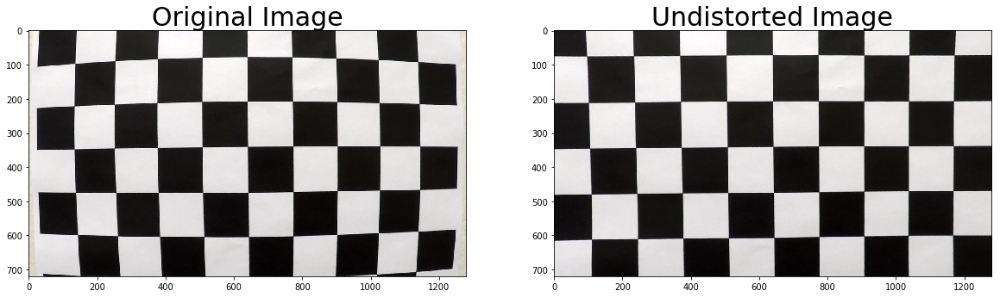

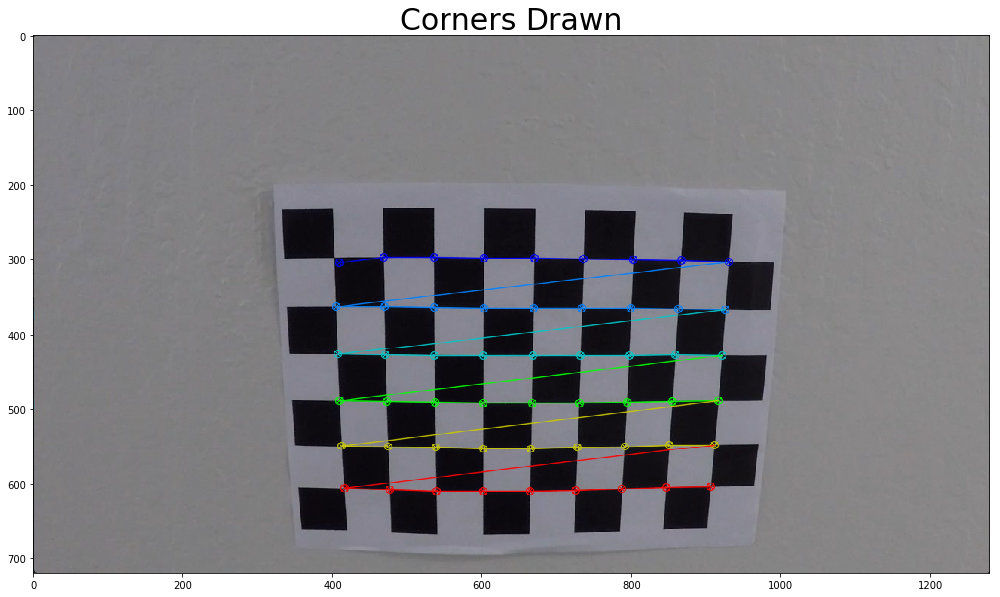

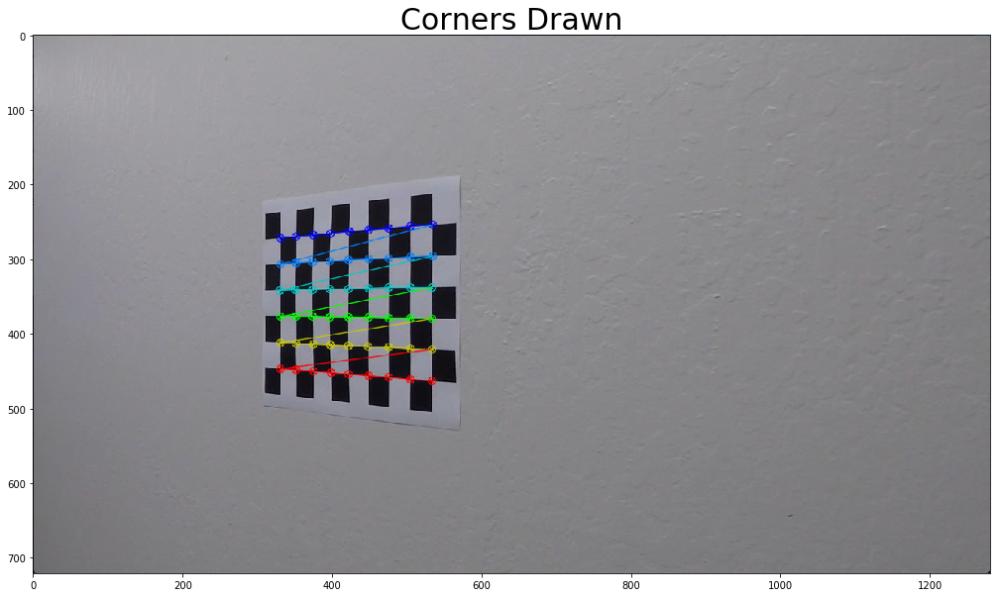

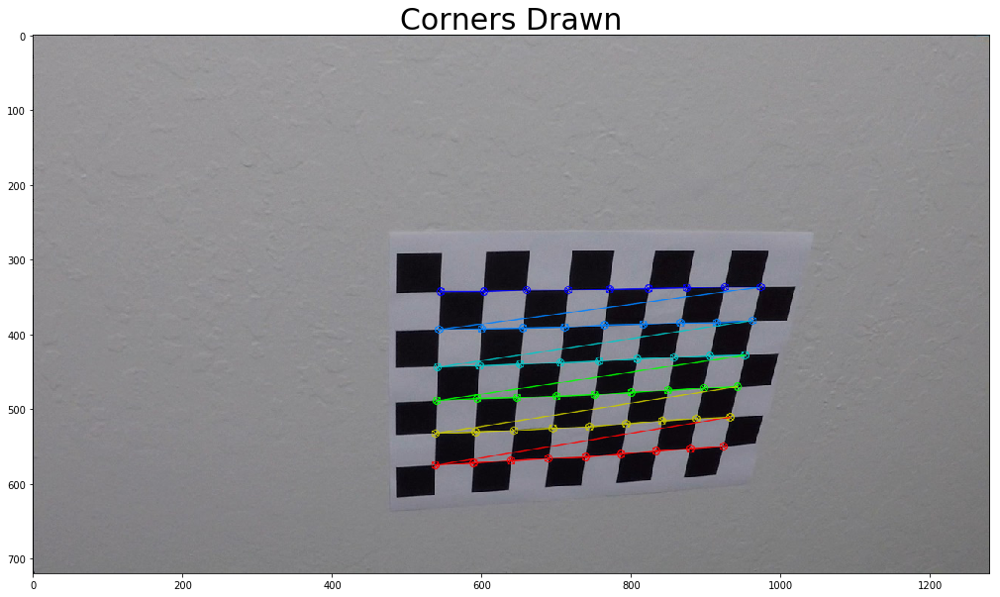

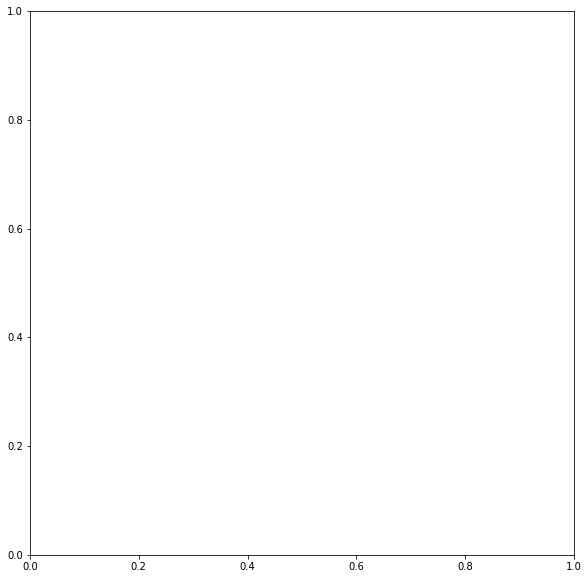

...

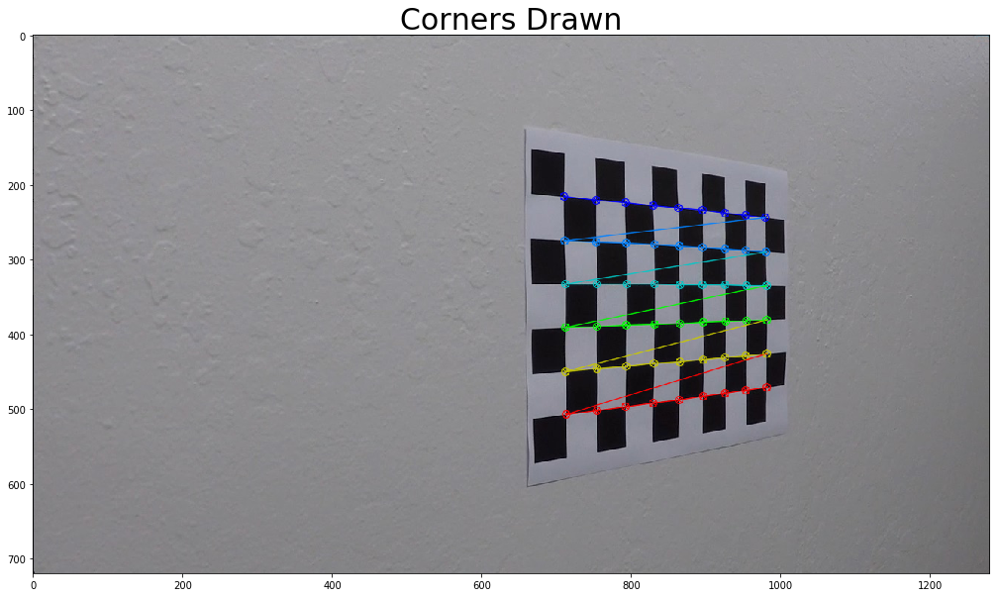

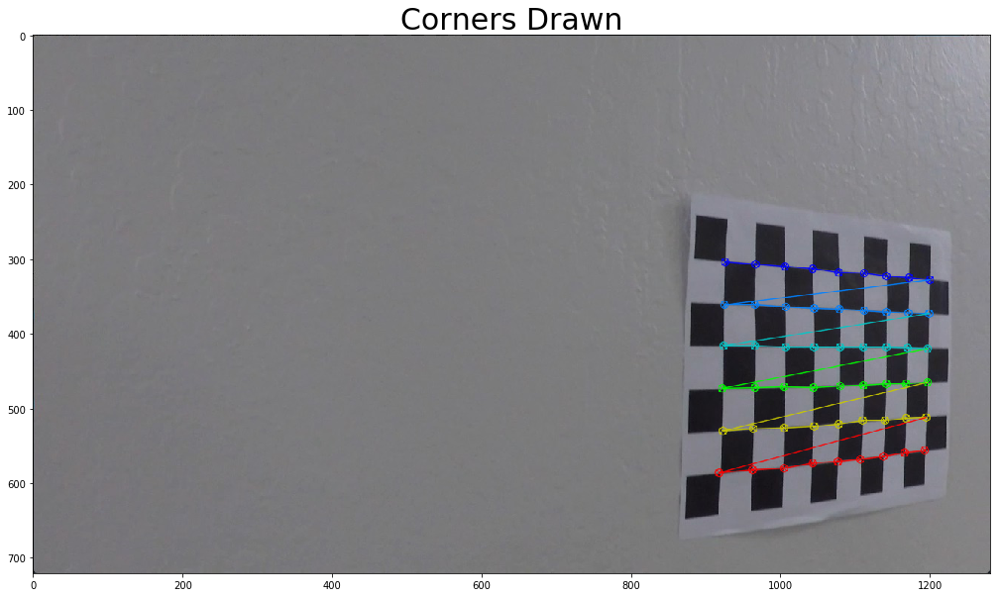

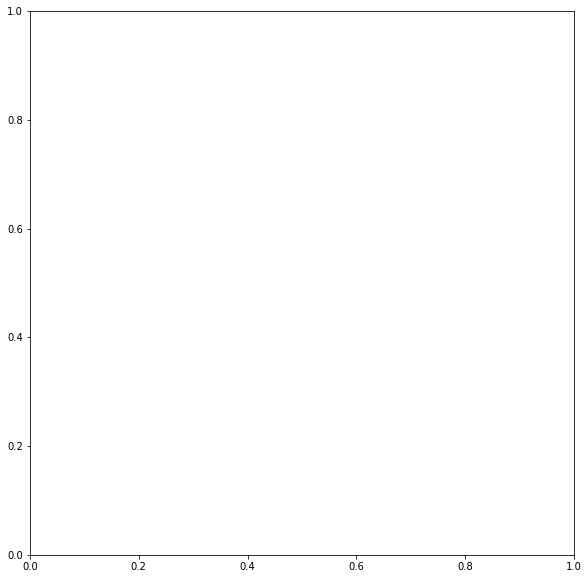

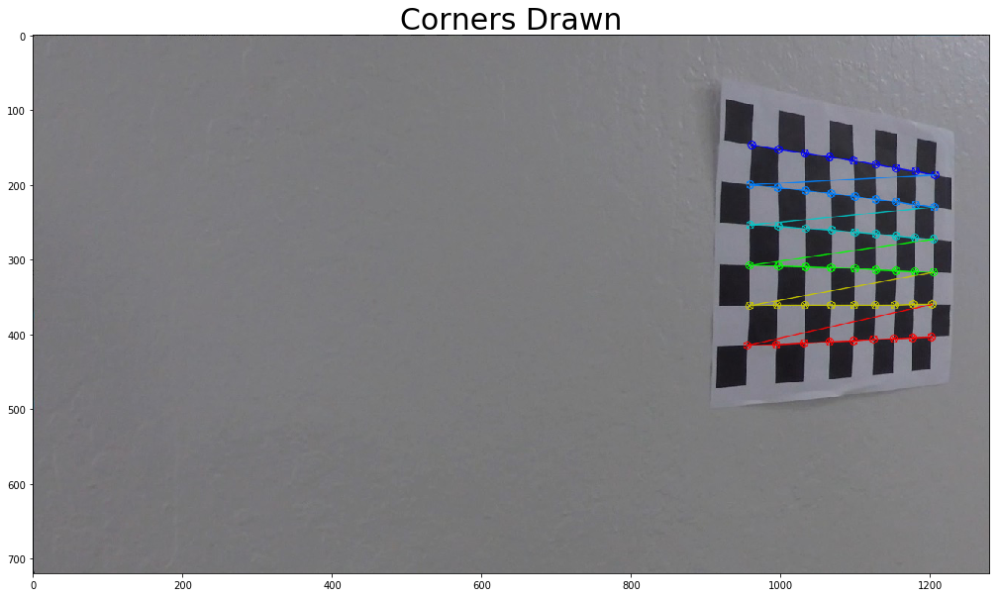

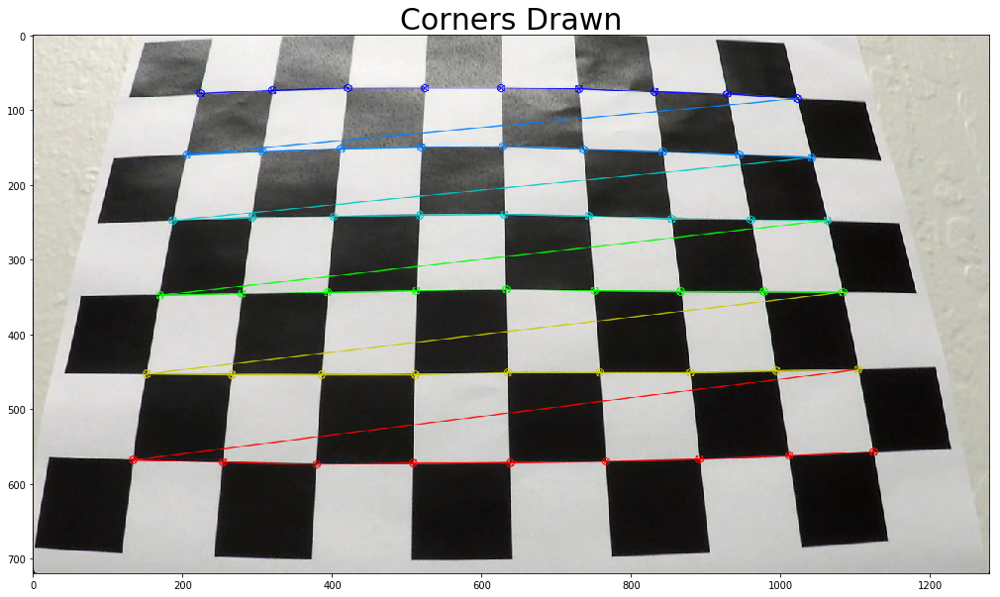

In [67]:
#Location of folders
CAMERA_CALIBRATION_FOLDER = "../camera_cal/"
CALIBRATED_OUTPUT_FOLDER  = OUTPUT_FOLDER + "calibrated_images/"

#Load the calibration images list
image_list = os.listdir(CAMERA_CALIBRATION_FOLDER)

#Pattern of the chessboard loaded
pattern = (9,6) #As mentioned in Project Rubric

#Calculating the object points.
#This is same unless the chessboard pattern is changed.
objp = np.zeros((pattern[1]*pattern[0],3),np.float32)
objp[:,:2] = np.mgrid[0:pattern[0],0:pattern[1]].T.reshape(-1,2)

#Finds the corners of the chessboard and draws on the image
def draw_corners(image):
    #Convert to grayscale
    gray = cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    #Finding the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray,pattern, None)
    if ret == True:
        #Drawing the chessboard corner on the input image
        img = np.copy(image)
        img = cv2.drawChessboardCorners(image, pattern, corners, ret)
        return(objp,corners,img)
    else:
        return(None,None,None)

#Finds the corners on all the calibration images and shows the output.
#Call this if wanted.It does nothing other than display.
def draw_all_images():
    for each in image_list:
        image = mpimg.imread(CAMERA_CALIBRATION_FOLDER + each) 
        try:
            ret = draw_corners(image)
            #Visualization of the result
            f, ax = plt.subplots(1, 1, figsize=(20,10))
            ax.imshow(ret[2])
            ax.set_title('Corners Drawn', fontsize=30)
            f.savefig(CALIBRATED_OUTPUT_FOLDER + each[:-4] + '.png')
        except:
            pass

#Calibrates an image
def calibrate(image):
    #Initialize variables
    object_points= []
    image_points = []
    img_size = (image.shape[1], image.shape[0])
    
    #Find Corners
    ret = draw_corners(image)
    object_points.append(ret[0])
    image_points.append(ret[1])
    
    # Does camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_points, image_points,img_size,None,None)
    
    return(mtx,dist)

#Calibrates the camera with the set of images available in CAMERA_CALIBRATION_FOLDER folder
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def camera_calibrate():
    count = 0
    for each in image_list:
        #Initialize variables
        mtx_list = np.zeros((3,3),dtype=float)
        dist_list = np.zeros((1,5),dtype=float)
        image = mpimg.imread(CAMERA_CALIBRATION_FOLDER + each)
        try:
            #Calibrates image
            mtx,dist= calibrate(image)
            #Keeps adding the camera matrix and distortion matrix correspondingly 
            mtx_list = mtx_list + mtx
            dist_list = dist_list + dist
            count = count+1
        except:
            pass
        
    #Average the camera matirces
    mtx_ave = mtx_list/count
    #Apply the camera matrix correction factor
    mtx_cor = mtx_factor*mtx_ave
    
    #Average the distortion matirces
    dist_ave = dist_list/count
    #Apply the distortion matrix correction factor
    dist_cor = dist_factor*dist_ave
    
    return mtx_cor,dist_cor

#Calibrate the camera
mtx,dist = camera_calibrate()
print("Camera Calibrated....")

## The following is just to visualize the transform.
image = mpimg.imread(CAMERA_CALIBRATION_FOLDER +'calibration1.jpg')
undist = cv2.undistort(image, mtx, dist, None, mtx)
#Visualization of the result
f, ax = plt.subplots(1, 2, figsize=(20,10))
ax[0].imshow(image)
ax[0].set_title('Original Image', fontsize=30)
ax[1].imshow(undist)
ax[1].set_title('Undistorted Image', fontsize=30)

#Uncomment the following line to draw the corners on the calibration images.
#draw_all_images()


#### PERSPECTIVE CALCULATION
Run the following cell and it calculates the perspective transform and inverse perspective transform matrices.
*This needs to be done only once unless the position or orientation of the camera is changed*

Calculated Perspective....


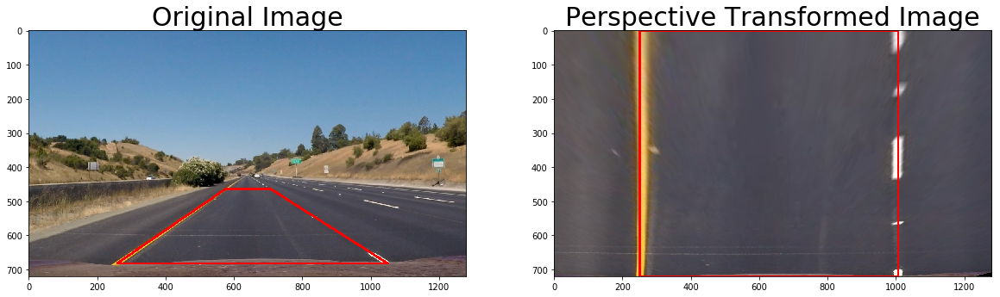

In [21]:
#Calculates the perscpective matrices
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def calculate_perspective():
    #Choosing a straight line image for calculation
    image = mpimg.imread(TEST_IMAGES_FOLDER+'straight_lines1.jpg')
    h,w = image.shape[:2]
    #Source points on the original image which looks like trapezoidal
    src = np.float32([(575,464),
                      (707,464), 
                      (258,682), 
                      (1049,682)])
    
    #Destination points on warped image which loooks like rectangle
    dst = np.float32([(250,0),
                      (w-275,0),
                      (250,h),
                      (w-275,h)])

    #Forward Transform
    M = cv2.getPerspectiveTransform(src, dst)
    #Inverse Transform
    Minv = cv2.getPerspectiveTransform(dst,src)

    ## The following is just to visualize the transform.
    #Copy the original image
    orig = np.copy(image)
    #Draw the source points on the image
    pts_src = np.array([[src[0],src[1],src[3],src[2]]], np.int32)
    pts_src = pts_src.reshape((-1,1,2))
    orig = cv2.polylines(orig,[pts_src],isClosed = True, color=(255,0,0), thickness=5)

    #Warp Using the calculated perspective
    dest = np.copy(image)
    dest = cv2.warpPerspective(dest, M, (w,h), flags=cv2.INTER_LINEAR)    
    #Draw the destination points on the warped image
    pts_dst = np.array([[dst[0],dst[1],dst[3],dst[2]]], np.int32)
    pts_dst = pts_dst.reshape((-1,1,2))
    dst = cv2.polylines(dest,[pts_dst],isClosed = True, color=(255,0,0), thickness=5)
    
    #Visualization of the result
    f, ax = plt.subplots(1, 2, figsize=(20,10))
    ax[0].imshow(orig)
    ax[0].set_title('Original Image', fontsize=30)
    ax[1].imshow(dst)
    ax[1].set_title('Perspective Transformed Image', fontsize=30)
    
    return M,Minv

M,Minv = calculate_perspective()
print("Calculated Perspective....")

#### UNDISTORTION MODULE
Run the following cell and it loads the undistortion module.

These images are stored in the folder :  ./output_images/distortion_corrected_images/

Loaded Undistortion Module....


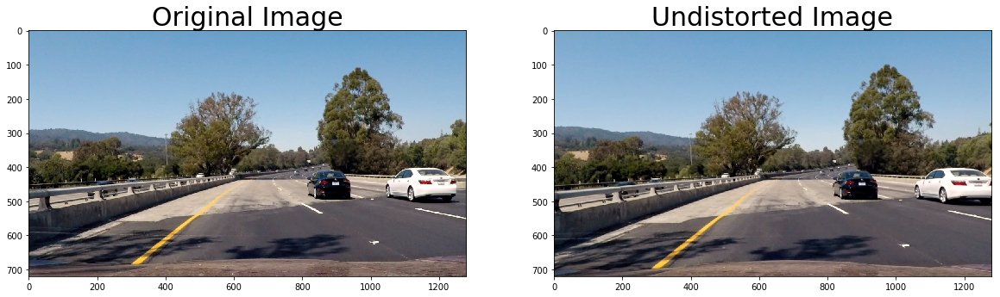

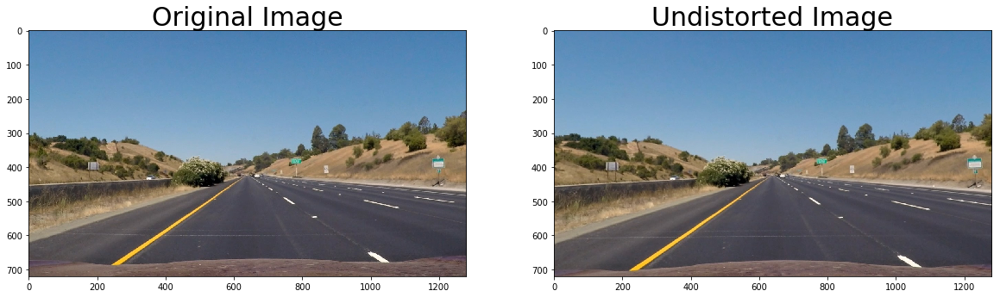

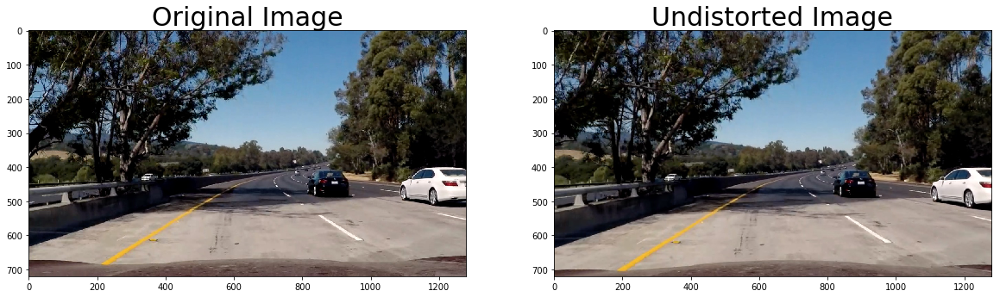

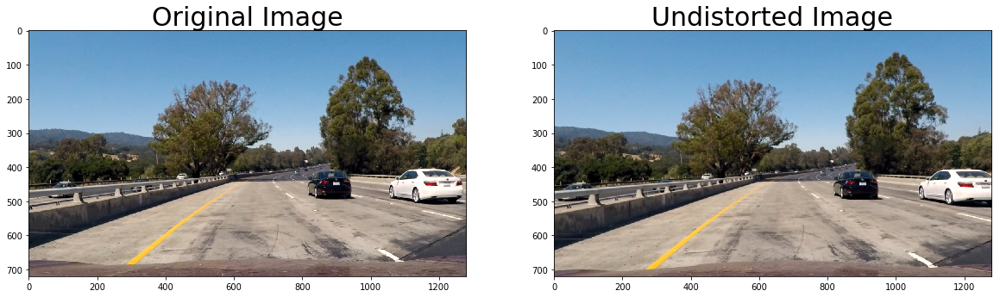

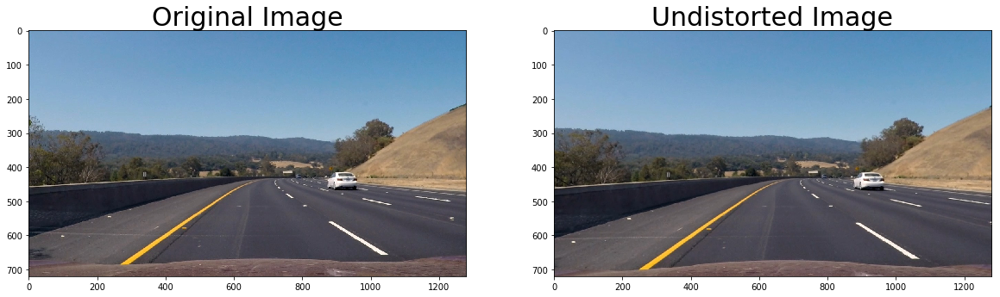

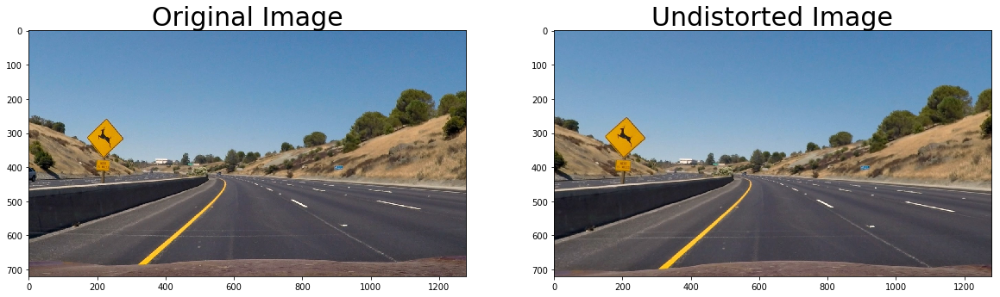

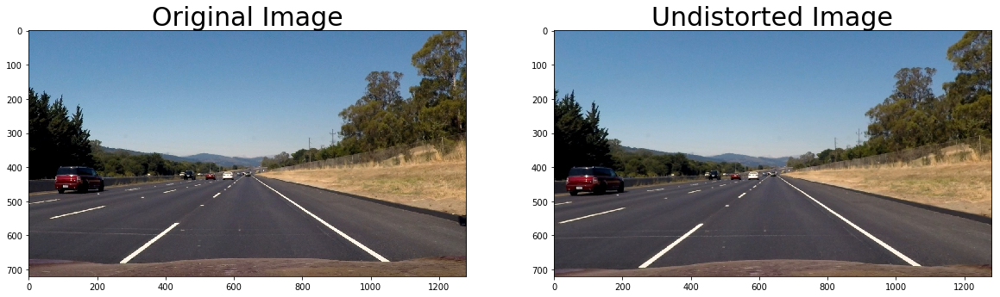

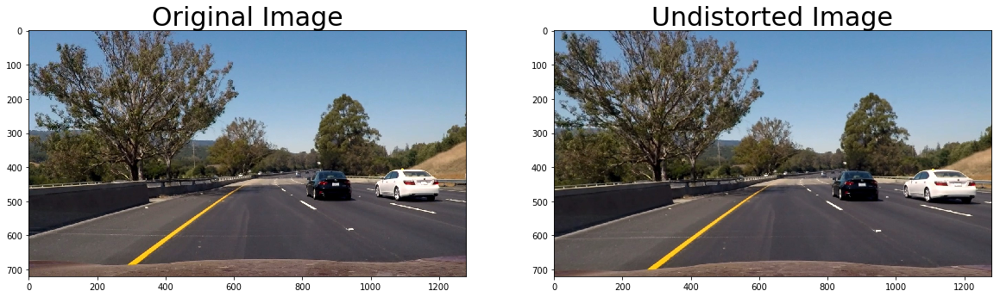

In [31]:
#Location of folder
DISTORTION_CORRECTED_FOLDER = OUTPUT_FOLDER + 'distortion_corrected_images/'

#Set this True to execute this cell and visualize the output
__exec__undistort__ = False

#Function that undistorts the input image
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def undistort(image):
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    return undist

if __exec__undistort__ == True:
    #Distortion Correction of all the images
    for each in test_images:
        image = mpimg.imread(TEST_IMAGES_FOLDER + each)
        #Undistort the image
        undist = undistort(image)
        
        #Visualization of the result
        f, ax = plt.subplots(1, 2, figsize=(20,10))
        ax[0].imshow(image)
        ax[0].set_title('Original Image', fontsize=30)
        ax[1].imshow(undist)
        ax[1].set_title('Undistorted Image', fontsize=30)
        f.savefig(DISTORTION_CORRECTED_FOLDER + each[:-4] +'.png')
    print("These images are stored in the folder : ",DISTORTION_CORRECTED_FOLDER)

__exec__undistort__ = False
print("\nLoaded Undistortion Module....")

#### GRADIENT AND COLOR THRESHOLD MODULE
Run the following cell and it loads the threshold module

These images are stored in the folder :  ./output_images/threshold_output/

Loaded Threshold Module....


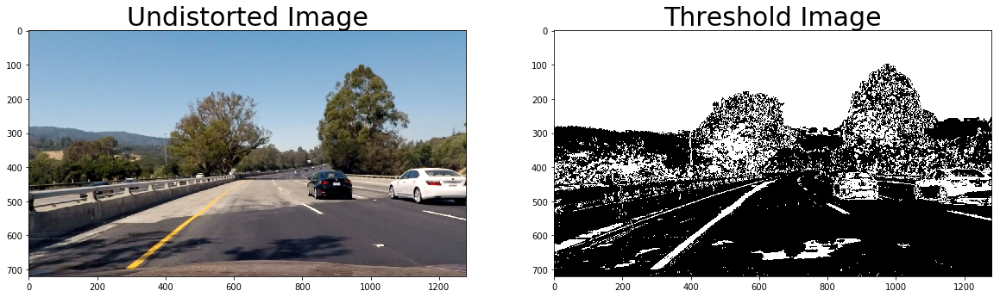

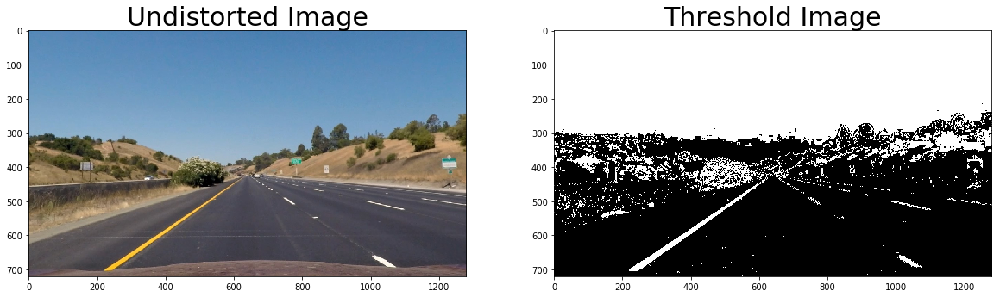

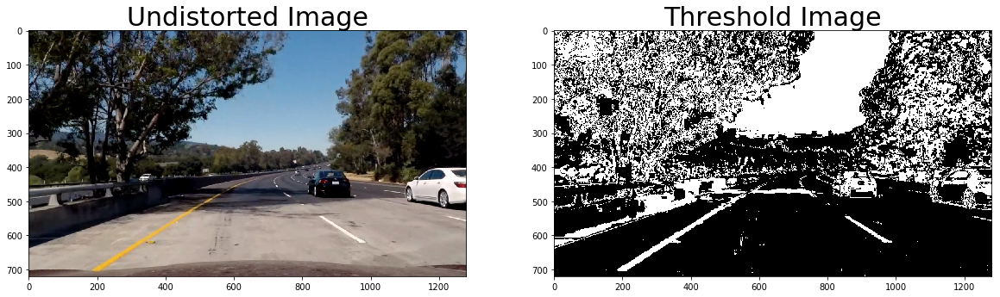

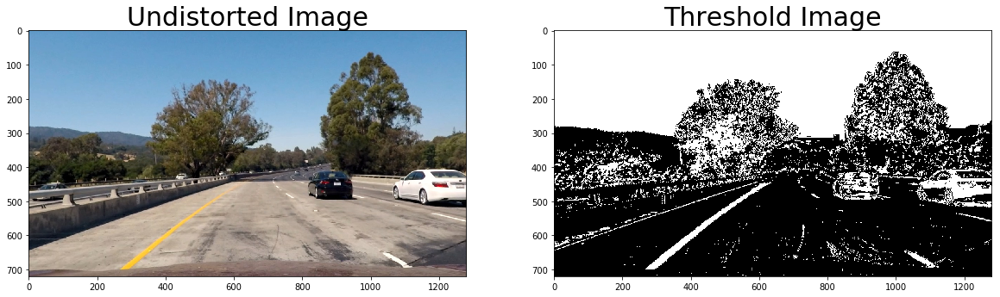

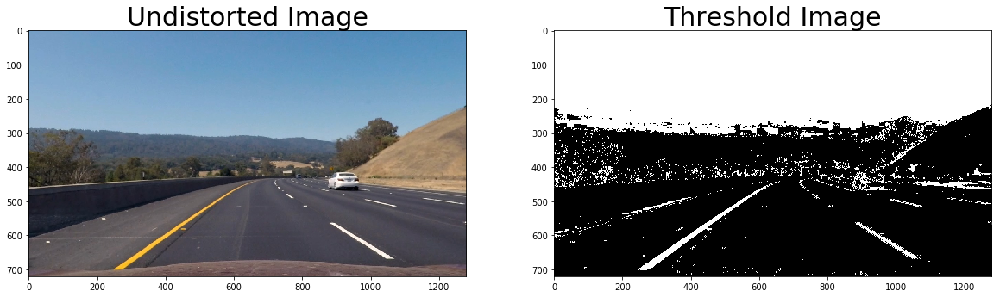

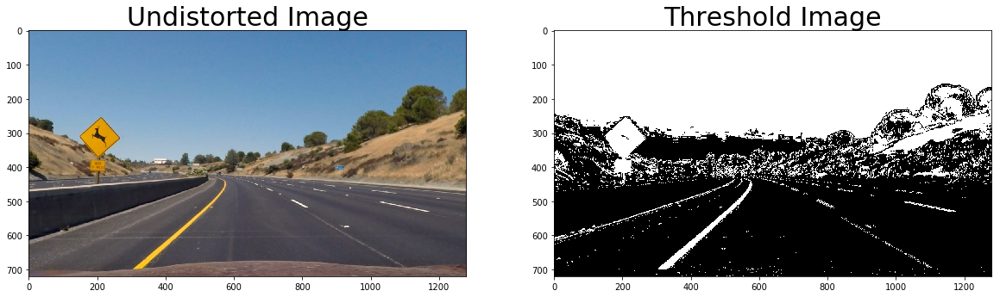

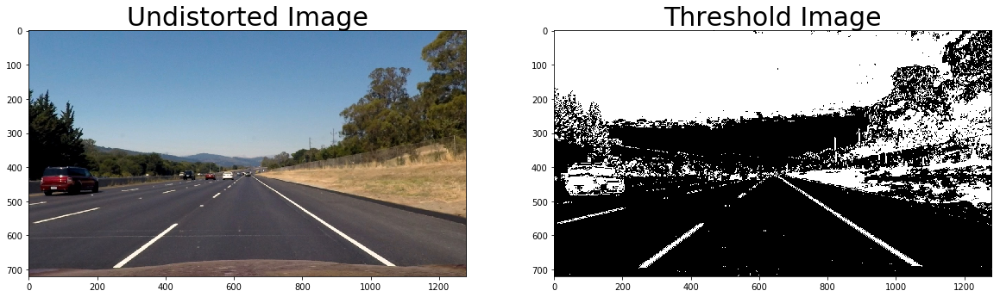

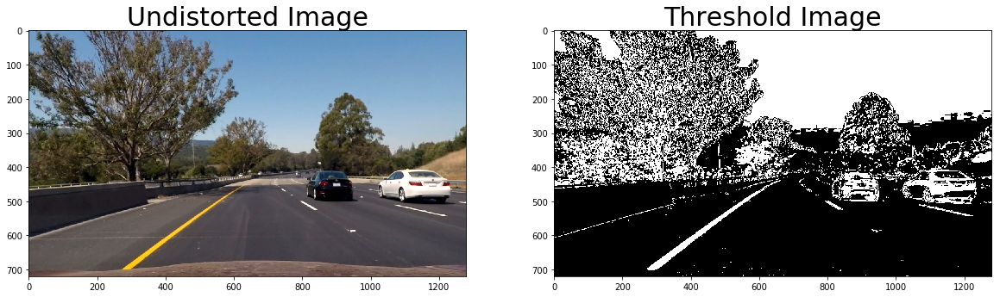

In [32]:
#Location of folder
THRESHOLDED_FOLDER = OUTPUT_FOLDER + 'threshold_output/'

#Set this True to execute this cell and visualize the output
__exec__threshold__ = False

#Function that applies Sobel x or y then takes an absolute value and applies a threshold.
def abs_sobel_thresh(img, orient='x',sobel_kernel=3, thresh=(0,255)):
    #Converts to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #Takes the derivative in x or y given orient = 'x' or 'y'
    sobel = cv2.Sobel(gray, cv2.CV_64F, orient=='x', orient=='y')
    #Takes the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    #Scales to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    #Creates a mask of 1's where the scaled gradient magnitude 
    # is > thresh_min and < thresh_max
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    binary_output = sxbinary 
    return binary_output

#Function that thresholds the S-channel of HLS
def S_color_threshold(image, thresh=(0,255)):
    #Converts to HLS color space
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    # Applies a threshold to the S channel
    binary_output = np.zeros_like(S)
    binary_output[((S > thresh[0]) & (S <= thresh[1]))]  =  1

    return binary_output

#Function that applies gradient threshold in x axis and color threshold in S-channel of HLS color space
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def threshold_image(image,ksize = 3,grad_thresh=(20,100),color_thresh=(90,255)):
    #Applies gradient threshold in x axis
    gradx_bin = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=grad_thresh)
    #Applies color threshold in S-channel of HLS color space
    S_bin = S_color_threshold(image,thresh=color_thresh)
    #Combines the above thresholded binaries
    threshold_bin = np.zeros_like(gradx_bin)
    threshold_bin[(gradx_bin == 1)|(S_bin == 1)] = 1
    
    return threshold_bin

if __exec__threshold__ == True:
    #Thresholding of all the images
    for each in test_images:
        image = mpimg.imread(TEST_IMAGES_FOLDER + each)
        #Undistort the image
        undist = undistort(image)
        #Apply the threshold
        threshold = threshold_image(undist)
        
        #Visualization of the result
        f, ax = plt.subplots(1, 2, figsize=(20,10))
        ax[0].imshow(undist)
        ax[0].set_title('Undistorted Image', fontsize=30)
        ax[1].imshow(threshold,cmap='Greys_r')
        ax[1].set_title('Threshold Image', fontsize=30)
        f.savefig(THRESHOLDED_FOLDER + each[:-4] +'.png')
    print("These images are stored in the folder : ",THRESHOLDED_FOLDER)

__exec__threshold__ = False
print("\nLoaded Threshold Module....")

#### WARP MODULE
Run the following cell and it loads the warping module

These images are stored in the folder :  ./output_images/warped_corrected_images/

Loaded Warping Module....


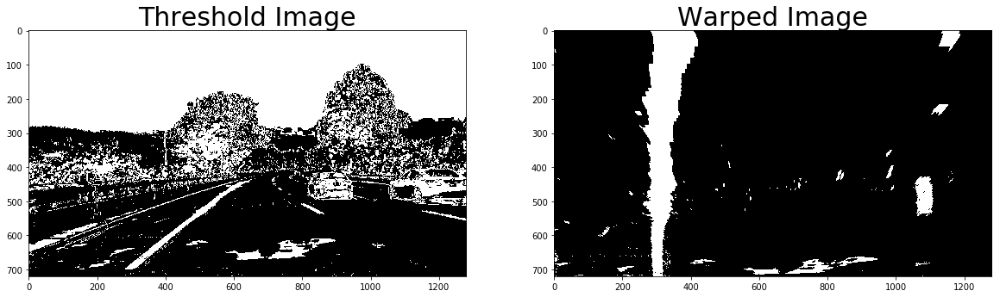

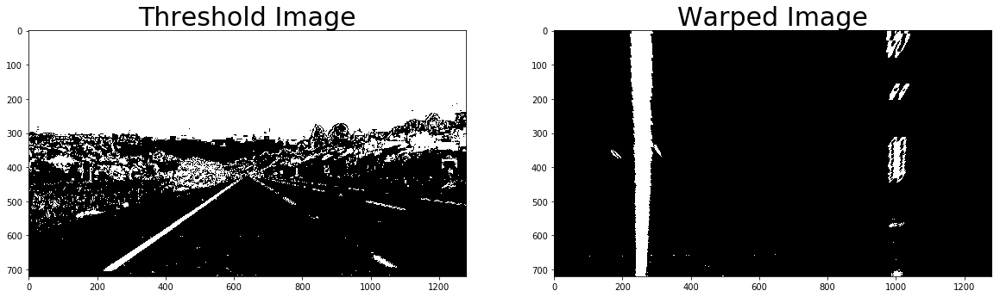

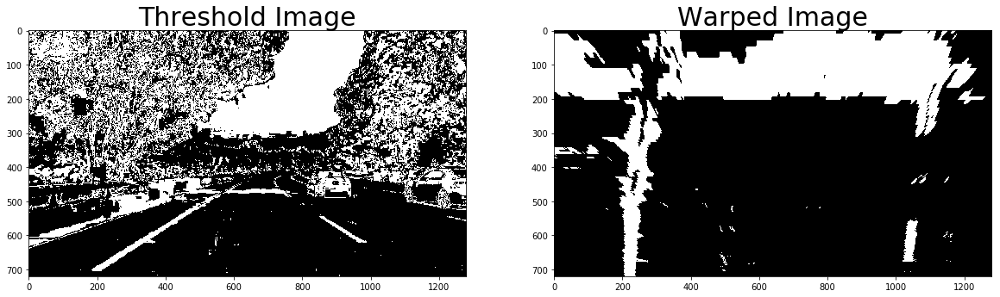

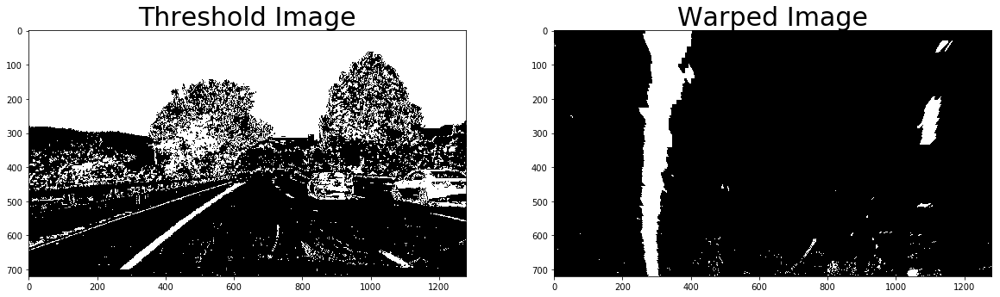

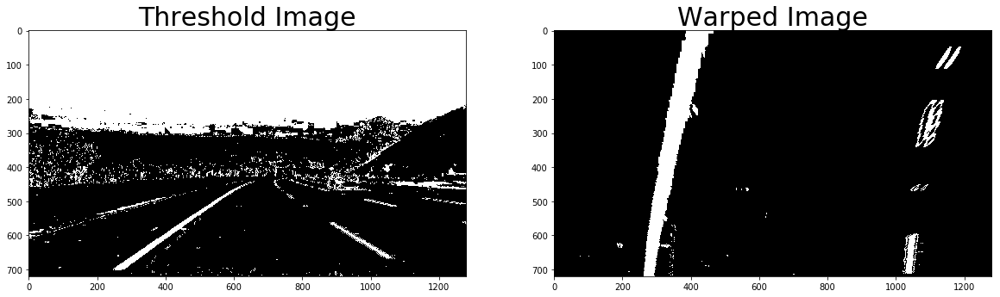

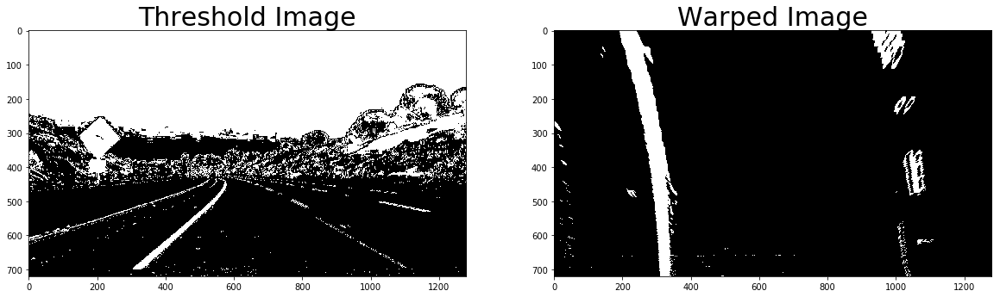

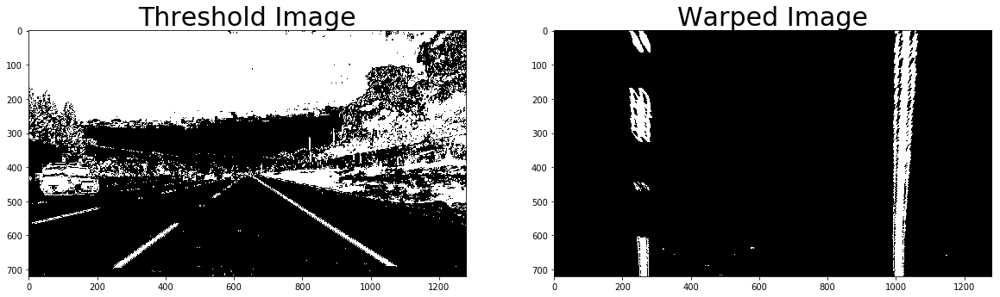

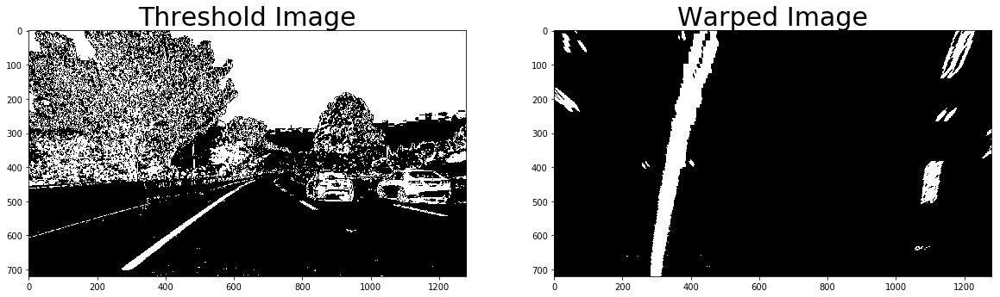

In [35]:
#Location of folder
WARPED_CORRECTED_FOLDER = OUTPUT_FOLDER + 'warped_corrected_images/'

#Set this True to execute this cell and visualize the output
__exec__warp__ = False

#Function that does the forward warping of image (changes the perspective)
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def warp_image(image):
    height,width = image.shape[:2]

    warped = cv2.warpPerspective(image, M, (width,height), flags=cv2.INTER_LINEAR)    
    
    return warped

#Function that does the inverse warping of image (changes the perspective)
#THIS IS ALSO THE MAIN FUNCTION OF THIS MODULE
def unwarp_image(image):
    height,width = image.shape[:2]

    unwarped = cv2.warpPerspective(image, Minv, (width,height), flags=cv2.INTER_LINEAR)    
    
    return unwarped


if __exec__warp__ == True:
    #Warping all the images
    for each in test_images:
        image = mpimg.imread(TEST_IMAGES_FOLDER + each)
        #Undistort the image
        undist = undistort(image)
        #Apply the threshold
        threshold = threshold_image(undist)
        #Warp the image
        warped = warp_image(threshold)
        #Visualization of the result
        f, ax = plt.subplots(1, 2, figsize=(20,10))
        ax[0].imshow(threshold,cmap='Greys_r')
        ax[0].set_title('Threshold Image', fontsize=30)
        ax[1].imshow(warped,cmap='Greys_r')
        ax[1].set_title('Warped Image', fontsize=30)
        f.savefig(WARPED_CORRECTED_FOLDER + each[:-4] +'.png')
    print("These images are stored in the folder : ",WARPED_CORRECTED_FOLDER)

__exec__warp__ = False
print("\nLoaded Warping Module....")

#### SLIDING WINDOW MODULE
Run the following cell and it loads the module to find the lanes using sliding window technique

These images are stored in the folder :  ./output_images/slide_window_output/

Loaded Sliding Window Module....


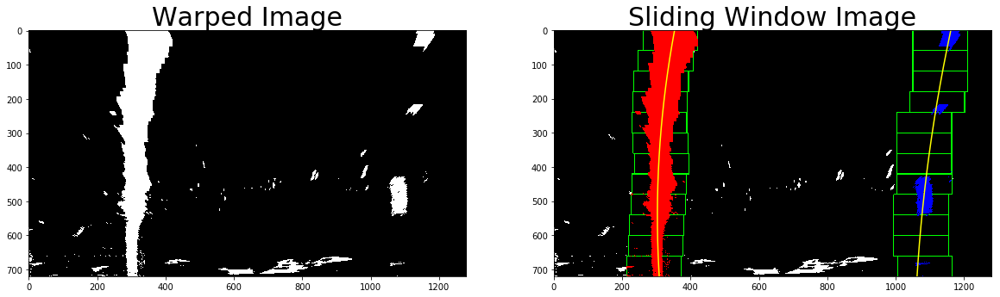

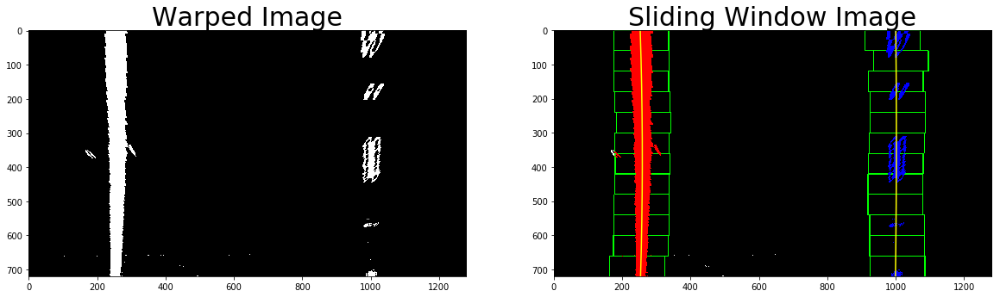

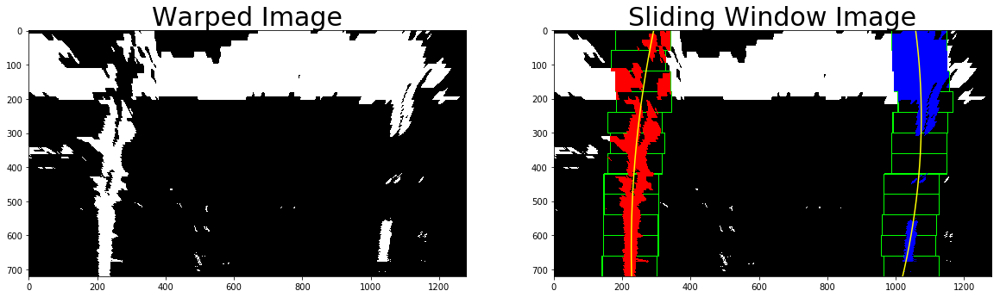

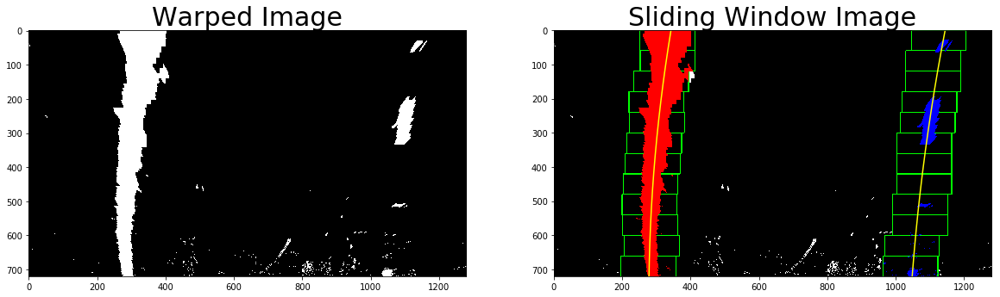

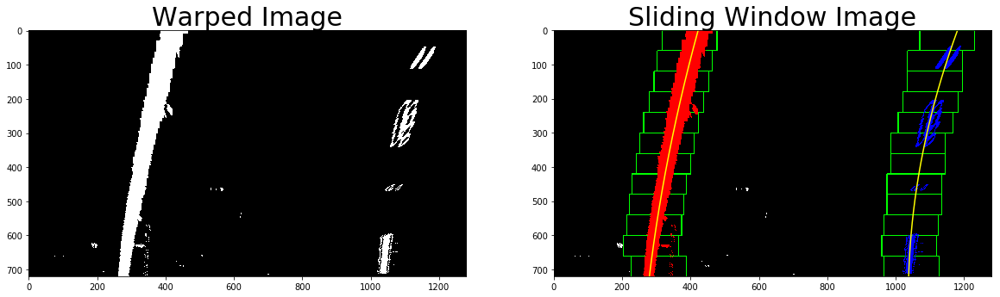

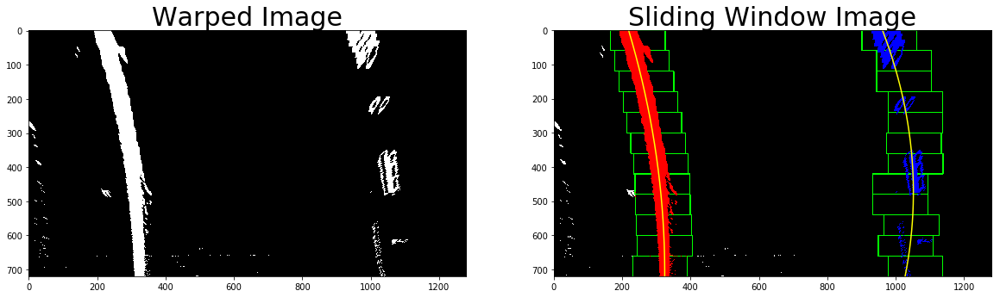

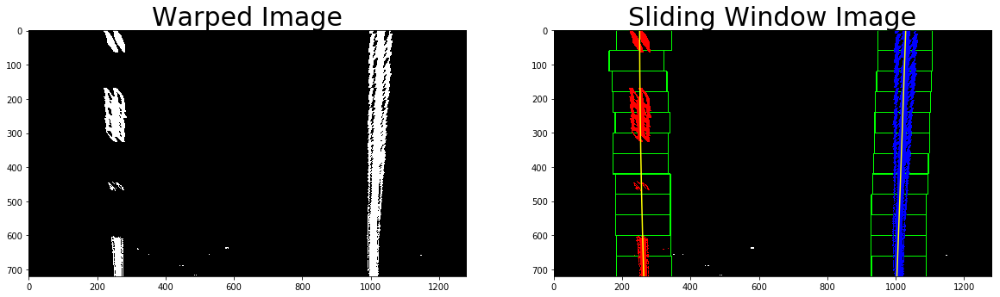

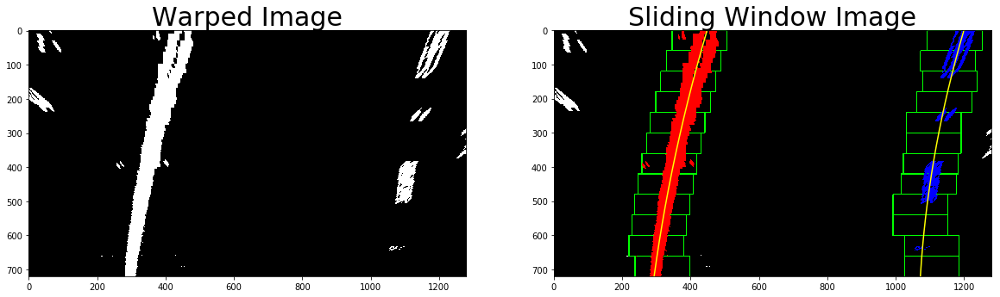

In [36]:
#Location of folder
SLIDE_WINDOW_OUTPUT = OUTPUT_FOLDER+'slide_window_output/'

#Set this True to execute this cell and visualize the output
__exec__slide__window__ = False

#Function that finds the lane using sliding window techinque
#THIS IS THE MAIN FUNCTION OF THIS MODULE
#each argument is just used in visualiztion of this cell. It is not needed in actual pipeline
def sliding_window_polyfit(binary_warped,each = None):
    # Takes a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Creates an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Finds the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 12
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    #Visualization of the result
    if __exec__slide__window__ == True:
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        
        f, ax = plt.subplots(1, 2, figsize=(20,10))
        ax[0].imshow(binary_warped,cmap='Greys_r')
        ax[0].set_title('Warped Image', fontsize=30)
        ax[1].imshow(out_img)
        ax[1].set_title('Sliding Window Image', fontsize=30)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)  
        f.savefig(SLIDE_WINDOW_OUTPUT + each[:-4] +'.png')

    return left_fit,right_fit,left_lane_inds,right_lane_inds

if __exec__slide__window__ == True:
    #Find lanes in all images
    for each in test_images:
        image = mpimg.imread(TEST_IMAGES_FOLDER + each)
        #Undistort the image
        undist = undistort(image)
        #Apply the threshold
        threshold = threshold_image(undist)
        #Warp the image
        warped = warp_image(threshold)
        #Find the lane
        ret = sliding_window_polyfit(warped,each)
        
        #mpimg.imsave(SLIDE_WINDOW_OUTPUT + each[:-4] +'.png',ret[0])
    print("These images are stored in the folder : ",SLIDE_WINDOW_OUTPUT)

__exec__slide__window__ = False
print("\nLoaded Sliding Window Module....")

#### polyfit_using_known_polyfit Module
Run the following cell and it loads the module to find the lanes using a known fit.

In [44]:
#Function that finds the lane using a known fit
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def polyfit_using_known_polyfit(binary_warped,left_fit,right_fit):
    # Skip the sliding windows step once you know where the lines are

    # Now you know where the lines are you have a fit! In the next frame of video you don't need to do a blind search again,
    # but instead you can just search in a margin around the previous line position like this:

    #Find indices of Nonzero in image    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    #Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return left_fit,right_fit,left_lane_inds,right_lane_inds

print("Loaded polyfit_using_known_polyfit module....")

Loaded polyfit_using_known_polyfit module....


#### MEASUREMENT MODULE
Run the following cell and it loads the module to find the radius of curvature of lane lines and to find the distance of the car from the center of lanes

In [37]:
#Set this True to execute this cell and visualize the output
__exec__measurement__ = False

#Function that measures radius of curvature and distance of the car from middle of lane
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def radius_of_curvature_and_centre_error(binary_warped,left_fit,right_fit,left_lane_inds,right_lane_inds):
    height,width = binary_warped.shape
    #Find indices of Nonzero in image    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    #Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    ploty = np.linspace(0,height-1,height)
    y_eval = np.max(ploty)

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    ##Calculate the radii of curvature in m
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    ##Calculate the distance of the car from middle of lane
    #Assuming that the camera is mounted at the center of the car
    car_mid = (width/2)
    #Left lane base point
    left_base = left_fit[0]*height**2 + left_fit[1]*height + left_fit[2]
    #Right lane base point
    right_base = right_fit[0]*height**2 + right_fit[1]*height + right_fit[2]
    #Middle of the lanes at base point
    lane_mid =(left_base + right_base)/2
    #Distance of the car from middle of lane in m
    center_error = (car_mid - lane_mid)*xm_per_pix
    
    return(left_curverad,right_curverad,center_error)

if __exec__measurement__ == True:
    #Measure the parameters of the random test image
    #Change this to your wish
    image = mpimg.imread(TEST_IMAGES_FOLDER+'test2.jpg')
    #Undistort the image
    undist = undistort(image)
    #Apply the threshold
    threshold = threshold_image(undist)
    #Warp the image
    warped = warp_image(threshold)
    #Find the lane fit polynomials and lane points using sliding window techinque
    left_fit,right_fit,left_lane_inds,right_lane_inds = sliding_window_polyfit(warped)
    #Measure radius of curvature and distance of the car from middle of lane
    left_curverad,right_curverad,center_error = radius_of_curvature_and_centre_error(warped,left_fit,right_fit,left_lane_inds,right_lane_inds)
    
    #Visualization of the result
    print("Left Lane Radius of Curvature : ",left_curverad,'m')
    print("Right Lane Radius of Curvature: ",right_curverad,'m')
    print("Diff in centre of car and lane: ",center_error,'m')

__exec__measurement__ = False
print("\nLoaded Measurements Module....")

Left Lane Radius of Curvature :  786.181868888 m
Right Lane Radius of Curvature:  410.377928281 m
Diff in centre of car and lane:  -0.190485024791 m

Loaded Measurements Module....


#### DRAWING TOOLS
Run the following cell and it loads the tools to draw a four sided polygon on an image, lanes on an image, text on an image

In [39]:
#Draws a four sided polygon on an image
def create_four_sided_polygon(image,p1,p2,p3,p4,ignore_mask_color=255):
    #Create a masked edges image using cv2.fillPoly()
    mask = np.zeros_like(image)   
    vertices = np.array([[p1,p2,p3,p4]], dtype=np.int32)
    return(cv2.fillPoly(mask, vertices, ignore_mask_color))

#Draws lanes on an image
def draw_lane_on_original_image(undist,warped,left_fit,right_fit,Minv):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Generate x and y values for plotting
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,0), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,0,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp_image(color_warp)

    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    return result

#Writes text on an image
def put_data_on_image(image,radius_of_curvature,center_error):
    #Format the radius of curvature text to write on the image
    radius_text = "Radius of Curvature = "+'{0}'.format(int(radius_of_curvature))+'(m)'
    #Find the direction on which the car is offset
    direction = ''
    if center_error < 0:
        direction = 'left'
    else:
        direction = 'right'
    #Format the position of the car from middle of lane text to write on the image
    center_text = "Vehicle is "+'{:04.2f}'.format(abs(center_error))+'m '+direction +' of centre'
    
    #Write the above texts on image
    cv2.putText(image,radius_text,(50,50),cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)
    cv2.putText(image,center_text,(50,100),cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)

    return(image)
    
print("Loaded Drawing Tools....")

Loaded Drawing Tools....


#### LINE class
Run the following cell and it loads the class used to keep track of infomation about previous image

In [40]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  
    
    #Update the fit if it is acceptable
    def update_fit(self,fit):
        #Check if the lanes are already detected
        if self.detected:
            #estimate the difference of available fit with the new fit
            diff = abs(fit - self.current_fit)
            #Check if the fit is acceptable and update accordingly
            if not ((diff[0] > 0.001) | 
                    (diff[1] > 1) |
                    (diff[2] > 100)):
                self.current_fit = fit 
                self.detected = True
            else:
                self.detected = False
        else:
            self.current_fit = fit
            self.detected = True
        
        return self.detected,self.current_fit
            
print("Loaded Line Class....")

Loaded Line Class....


#### PROCESS IMAGE
##### Final pipeline

Voila! Here comes the main module which uses all the above modules to find the lanes on an image.This is the pipeline to find the lanes.
Run the following cell and it loads the pipeline

These images are available in :  ./output_images/final_output/

Loaded lane finding pipeline for an image....


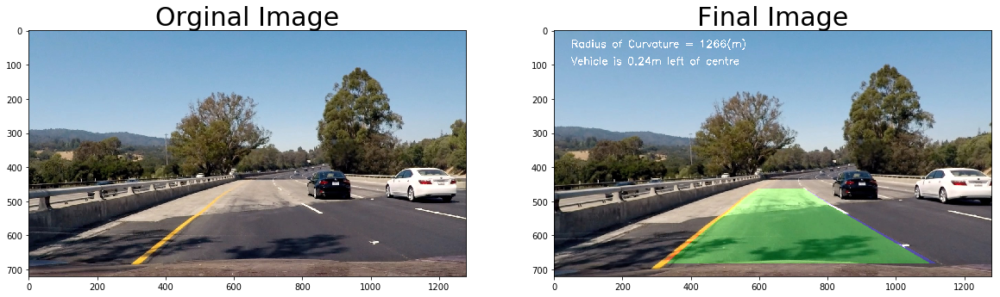

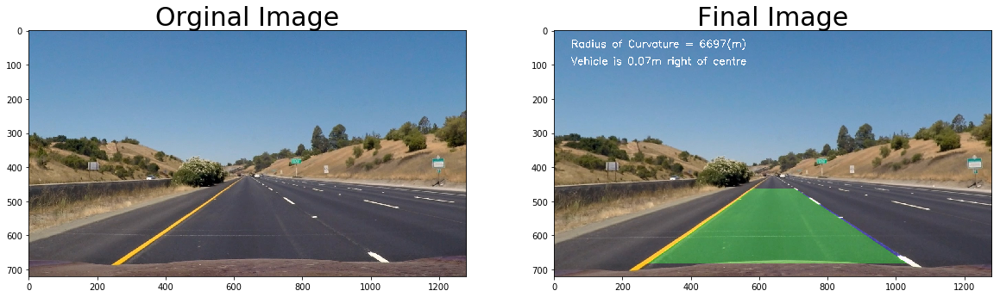

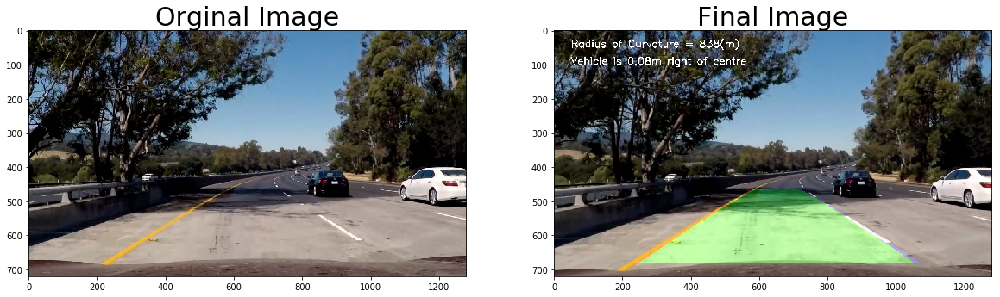

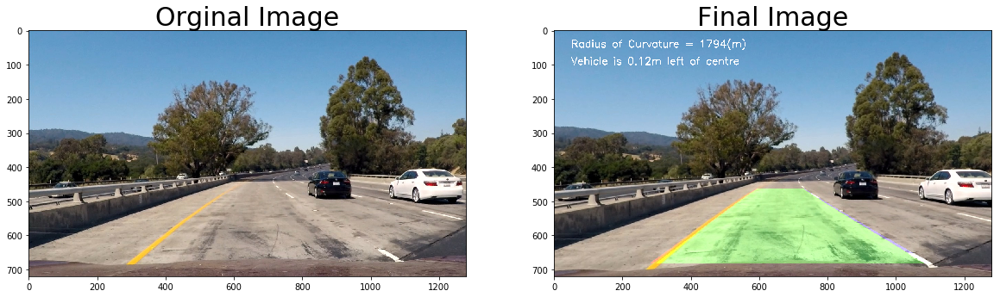

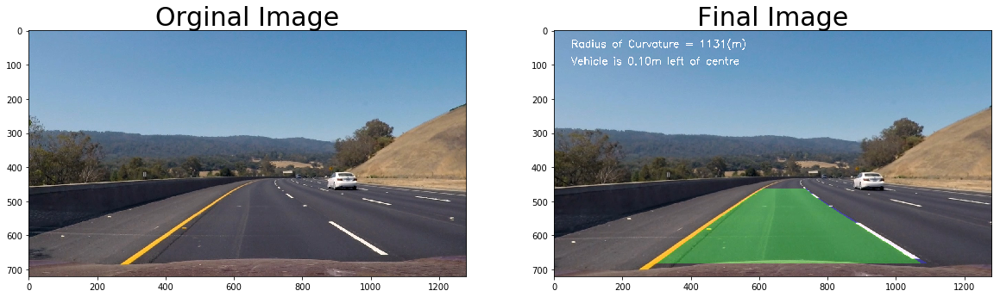

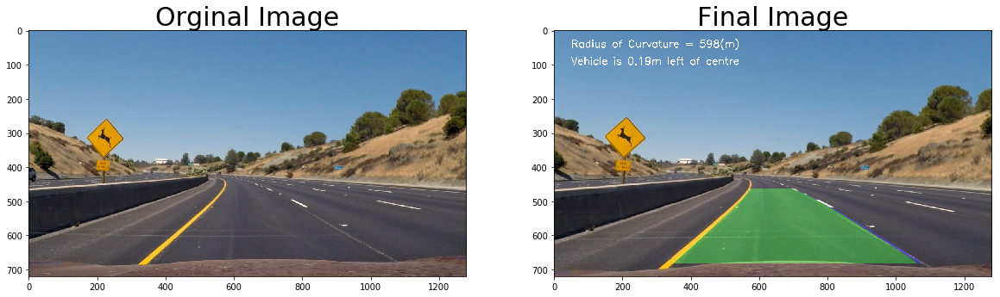

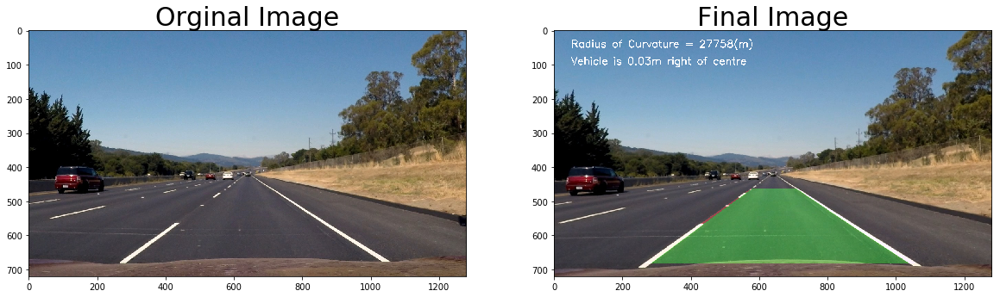

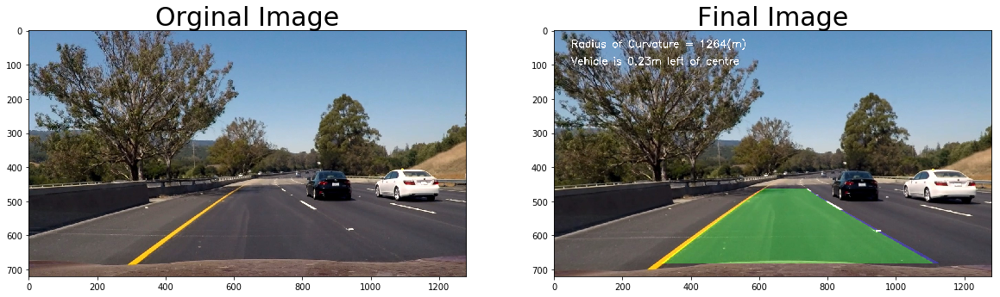

In [68]:
#Location of folder
FINAL_OUTPUT = OUTPUT_FOLDER + 'final_output/'
#Set this True to execute this cell and visualize the output
__exec__pipeline__ = False

#Pipeline which process the image and provides the final output
#THIS IS THE MAIN FUNCTION OF THIS MODULE
def process_image(image):
    height,width = image.shape[1::-1]
    #Step 1) Undistort the image
    undist = undistort(image)
    #Step 2) Apply the threshold
    threshold = threshold_image(undist)
    #Step 3) Warp the image
    warped = warp_image(threshold)
    
    #Step 4) Find the lanes
    ## Check if there is a previous fit available
    if (left_l.detected & right_l.detected):
        #Load the old fit
        left_fit_old = left_l.current_fit
        right_fit_old= right_l.current_fit
        #Find the lane fit polynomials and lane points using polyfit_using_known_polyfit technique
        left_fit,right_fit,left_lane_inds,right_lane_inds = polyfit_using_known_polyfit(warped,left_fit_old,right_fit_old)     
       
    else:   
        #Find the lane fit polynomials and lane points using sliding window techinque
        left_fit,right_fit,left_lane_inds,right_lane_inds = sliding_window_polyfit(warped)
    
    #Step 5) Update the current fit to the classes correspondingly       
    if len(left_fit) & len(right_fit):
        retl,left_fit = left_l.update_fit(left_fit)
        retr,right_fit = right_l.update_fit(right_fit)
    elif not len(left_fit):
        left_l.detected = False
    elif not len(right_fit):
        right_l.detected = False
    
    #Step 6) Measure radius of curvature and distance of the car from middle of lane
    left_curverad,right_curverad,center_error = radius_of_curvature_and_centre_error(warped,left_fit,right_fit,left_lane_inds,right_lane_inds)
    #Step 7) Draw the lanes on the input image
    lane_image = draw_lane_on_original_image(undist,warped,left_fit,right_fit,Minv)
    #Find the mean of radii of curvature. This can be taken as the radius of curvature of the road
    radius_of_curvature = (left_curverad+right_curverad)/2
    #Step 8) Write the measured values on the image
    final_image = put_data_on_image(lane_image,radius_of_curvature,center_error)
        
    return(lane_image)
 
if __exec__pipeline__ == True:
    #Find the lanes on all the images, draw the lanes and write the measured values
    for each in test_images:
        #Initialize the class everytime because this is not video and
        #images are not continous shots
        left_l = Line()
        right_l= Line()
        
        image = mpimg.imread(TEST_IMAGES_FOLDER+each)
        
        #Call the pipeline
        ret = process_image(image)
        
        #Visualization of the result
        f, ax = plt.subplots(1, 2, figsize=(20,10))
        ax[0].imshow(image)
        ax[0].set_title('Orginal Image', fontsize=30)
        ax[1].imshow(ret)
        ax[1].set_title('Final Image', fontsize=30)
        f.savefig(FINAL_OUTPUT+each[:-4]+'.png')
    print("These images are available in : ",FINAL_OUTPUT)
        
__exec__pipeline__ = False
print("\nLoaded lane finding pipeline for an image....")

### PROCESS TEST VIDEOS
#### The following cells does the processing of video and shows the output

#### PROJECT VIDEO
Process the project_video.mp4

In [63]:
#Initialize the classes to keep track of the lanes
left_l = Line()
right_l= Line()

#Output Location
project_video_output = './output_videos/project_video.mp4'
#Load the video
clip1 = VideoFileClip("../project_video.mp4")
#Start processing each frame
video_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#Write the processed images into a video
%time video_clip.write_videofile(project_video_output, audio=False)

[MoviePy] >>>> Building video ./output_videos/project_video.mp4
[MoviePy] Writing video ./output_videos/project_video.mp4


100%|█████████▉| 1260/1261 [05:36<00:00,  3.78it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_videos/project_video.mp4 

CPU times: user 3min 3s, sys: 25.2 s, total: 3min 28s
Wall time: 5min 39s


Want to see the output? Run the following cell !!! 

In [64]:
HTML("""
<video width="1280" height="720" controls>
  <source src="{0}">
</video>
""".format(project_video_output))

#### CHALLENGE VIDEO
Process the challenge_video.mp4

In [65]:
#Initialize the classes to keep track of the lanes
left_l = Line()
right_l= Line()

#Output Location
challenge_video_output = './output_videos/challenge_video.mp4'
#Load the video
clip1 = VideoFileClip("../challenge_video.mp4")
#Start processing each frame
video_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#Write the processed images into a video
%time video_clip.write_videofile(challenge_video_output, audio=False)

[MoviePy] >>>> Building video ./output_videos/challenge_video.mp4
[MoviePy] Writing video ./output_videos/challenge_video.mp4


100%|██████████| 485/485 [02:01<00:00,  3.98it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_videos/challenge_video.mp4 

CPU times: user 1min 6s, sys: 10.5 s, total: 1min 16s
Wall time: 2min 4s


Want to see the output? Run the following cell !!! 

In [66]:
HTML("""
<video width="1280" height="720" controls>
  <source src="{0}">
</video>
""".format(challenge_video_output))

#### HARDER CHALLENGE VIDEO
Process the harder_challenge_video.mp4

In [61]:
#Initialize the classes to keep track of the lanes
left_l = Line()
right_l= Line()

#Output Location
harder_challenge_video_output = './output_videos/harder_challenge_video.mp4'
#Load the video
clip1 = VideoFileClip("../harder_challenge_video.mp4")
#Start processing each frame
video_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#Write the processed images into a video
%time video_clip.write_videofile(harder_challenge_video_output, audio=False)

[MoviePy] >>>> Building video ./output_videos/harder_challenge_video.mp4
[MoviePy] Writing video ./output_videos/harder_challenge_video.mp4


100%|█████████▉| 1199/1200 [06:21<00:00,  3.18it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_videos/harder_challenge_video.mp4 

CPU times: user 3min 21s, sys: 24 s, total: 3min 45s
Wall time: 6min 25s


Want to see the output? Run the following cell !!! 

In [62]:
HTML("""
<video width="1280" height="720" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_video_output))